In [3]:
from matplotlib import pyplot as plt
import h5py
import numpy as np
import matplotlib.gridspec as gridspec
import random
from astroML.correlation import two_point
import stats
from tqdm import *
from scipy.spatial import distance
from scipy import spatial
from mpl_toolkits.mplot3d import Axes3D
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.offline as py_offline

cdm = h5py.File('Data/COLOR_CDM_DM_subHaloes_z0.00_v2.hdf5', 'r')
wdm = h5py.File('Data/COLOR_WDM_DM_subHaloes_z0.00_v2.hdf5', 'r')

cdm_galaxy = h5py.File('Data\COLOR_CDM_galaxies.hdf5', 'r')
wdm_galaxy = h5py.File('Data\COLOR_WDM_galaxies.hdf5', 'r')

print(cdm,wdm,cdm_galaxy,wdm_galaxy)

<HDF5 file "COLOR_CDM_DM_subHaloes_z0.00_v2.hdf5" (mode r)> <HDF5 file "COLOR_WDM_DM_subHaloes_z0.00_v2.hdf5" (mode r)> <HDF5 file "COLOR_CDM_galaxies.hdf5" (mode r)> <HDF5 file "COLOR_WDM_galaxies.hdf5" (mode r)>


# Access the masses and positions of CDM and WDM halos

In [4]:
# Access mass/position for wdm/cdm
print(list(cdm.keys()),list(wdm.keys()))

cdm_mass = cdm['SubhaloMass'][:]
cdm_position = cdm['SubhaloPos'][:]

wdm_mass = wdm['SubhaloMass'][:]
wdm_position = wdm['SubhaloPos'][:]

cdm_mass, cdm_position, wdm_mass, wdm_position

['IsCentral', 'R200', 'SubhaloMass', 'SubhaloPos'] ['IsCentral', 'R200', 'SubhaloMass', 'SubhaloPos']


(array([1.87617493e+14, 1.84468594e+14, 6.89978024e+13, ...,
        1.76011232e+08, 1.76011232e+08, 1.76011232e+08]),
 array([[10.93832207, 81.23078918, 54.77935028],
        [17.94562721, 79.86347961, 53.3843956 ],
        [15.62266159, 78.18474579, 52.83857346],
        ...,
        [ 1.47748184,  3.54455233, 99.53264618],
        [99.32190704,  2.56014371,  2.57368279],
        [99.0621109 ,  4.18381071,  2.89533401]]),
 array([1.89941540e+14, 1.86912732e+14, 6.83256610e+13, ...,
        1.76011232e+08, 1.76011232e+08, 1.76011232e+08]),
 array([[1.80150642e+01, 7.98655701e+01, 5.34328232e+01],
        [1.09048624e+01, 8.12610779e+01, 5.48179703e+01],
        [1.56323385e+01, 7.81665344e+01, 5.28157997e+01],
        ...,
        [6.02296066e+00, 5.05078554e+00, 9.79758301e+01],
        [5.75055540e-01, 3.26677370e+00, 3.52767438e-01],
        [2.07897183e-03, 3.23730040e+00, 9.97708917e-01]]))

# Access the masses and positions of CDM and WDM galaxies

In [5]:
# Access mass/position for wdm/cdm
print(list(cdm_galaxy.keys()),list(wdm_galaxy.keys()))

cdm_galaxy_color = cdm_galaxy['Colour'][:]
cdm_galaxy_position = cdm_galaxy['GalaxyPos'][:]
cdm_galaxy_mass = cdm_galaxy['StellarMass'][:]

wdm_galaxy_color = wdm_galaxy['Colour'][:]
wdm_galaxy_position = wdm_galaxy['GalaxyPos'][:]
wdm_galaxy_mass = wdm_galaxy['StellarMass'][:]

cdm_galaxy_color, cdm_galaxy_position, cdm_galaxy_mass, 
wdm_galaxy_color, wdm_galaxy_position,wdm_galaxy_mass

['Colour', 'GalaxyPos', 'IsCentral', 'StellarMass'] ['Colour', 'GalaxyPos', 'IsCentral', 'StellarMass']


(array([0.29584217, 0.29859257, 0.59355354, ..., 0.32156372, 0.59656096,
        0.32803154]), array([[17.61932182, 79.06235504, 52.68593979],
        [18.65647697, 80.58162689, 52.30108261],
        [18.58250046, 80.91363525, 52.45199203],
        ...,
        [76.68208313, 28.50509262, 59.96631622],
        [33.62237167,  9.74790382,  4.82571173],
        [52.58901978, 44.79496765, 78.47211456]]), array([3873670.  , 5328977.  , 1002360.25, ..., 2697151.5 ,  542400.5 ,
        2462471.  ]))

# Find central halos and central galaxies
### Make sure to filter out halos below the resolution limit

In [6]:
m_res = 1e9
print(m_res)

cdm_position_filtered_ind=np.where(cdm_mass>m_res)[0]
wdm_position_filtered_ind=np.where(wdm_mass>m_res)[0]

len(cdm_position),len(cdm_position_filtered_ind),len(wdm_position),len(wdm_position_filtered_ind)

1000000000.0


(4770041, 1006170, 3082275, 786312)

In [7]:
# find the indices of all the central halos
cdm_central_ind = np.where((cdm['IsCentral'][:] == 1)&(cdm_mass>m_res))[0]

print(cdm_central_ind)
print(len(cdm_mass[cdm_central_ind]))
print(cdm['IsCentral'][:][cdm_central_ind])

wdm_central_ind = np.where((wdm['IsCentral'][:] == 1)&(wdm_mass>m_res))[0]

[      0   20093   40287 ... 1672226 1672227 1672228]
803943
[1 1 1 ... 1 1 1]


In [8]:
cdm_galaxy_central_ind=np.where(cdm_galaxy['IsCentral'][:]==1)[0]
wdm_galaxy_central_ind=np.where(wdm_galaxy['IsCentral'][:]==1)[0]
print(cdm_galaxy['IsCentral'][:][cdm_galaxy_central_ind])

[1 1 1 ... 1 1 1]


In [9]:
#find positions of central galaxies
cdm_galaxy_position_central = cdm_galaxy_position[cdm_galaxy_central_ind]
wdm_galaxy_position_central = wdm_galaxy_position[wdm_galaxy_central_ind]

### Create trees of the wdm and cdm halos

In [ ]:
#create the trees
cdm_tree = spatial.cKDTree(cdm_position[cdm_position_filtered_ind])
wdm_tree = spatial.cKDTree(wdm_position[wdm_position_filtered_ind])

# Loop over the galaxies
### First do cdm

In [38]:
# create an empty array for the mass of the spheres
cdm_5Mpc_sphere_mass = []

#iterate through each central galaxy
for i in trange(len(cdm_galaxy_position_central)):
    #find the indices for all halos in a 5 Mpc radius around each central halo
    cdm_ind = cdm_tree.query_ball_point(cdm_galaxy_position_central[i], 5)
    #sum the mass of these halos
    cdm_5Mpc_sphere_mass.append(np.sum(cdm_mass[cdm_ind]))


 17%|████████████▍                                                            | 30949/181751 [00:15<01:06, 2272.74it/s]


 34%|████████████████████████▌                                                | 61286/181751 [00:30<00:49, 2448.07it/s]


 54%|███████████████████████████████████████                                  | 97251/181751 [00:45<00:34, 2439.34it/s]


 72%|███████████████████████████████████████████████████▉                    | 131174/181751 [01:00<00:27, 1810.94it/s]


 91%|█████████████████████████████████████████████████████████████████▍      | 165070/181751 [01:15<00:07, 2247.82it/s]


100%|████████████████████████████████████████████████████████████████████████| 181751/181751 [01:23<00:00, 2185.15it/s]

In [39]:
cdm_5Mpc_sphere_mass=np.array(cdm_5Mpc_sphere_mass)
np.savetxt("cdm_galaxy_5Mpc_sphere_mass.txt", cdm_5Mpc_sphere_mass, fmt = "%f")
len(cdm_5Mpc_sphere_mass), len(cdm_galaxy_central_ind)

(181751, 181751)

In [40]:
# create an empty array for the mass of the spheres
cdm_10Mpc_sphere_mass = []

#iterate through each central galaxy
for i in trange(len(cdm_galaxy_position_central)):
    #find the indices for all halos in a 5 Mpc radius around each central halo
    cdm_ind = cdm_tree.query_ball_point(cdm_galaxy_position_central[i], 10)
    #sum the mass of these halos
    cdm_10Mpc_sphere_mass.append(np.sum(cdm_mass[cdm_ind]))


  4%|███▏                                                                       | 7608/181751 [00:14<05:23, 538.87it/s]


  8%|██████▎                                                                   | 15444/181751 [00:29<04:24, 629.95it/s]


 13%|█████████▎                                                                | 22916/181751 [00:45<06:03, 436.98it/s]


 17%|████████████▎                                                             | 30303/181751 [01:00<04:27, 566.26it/s]


 21%|███████████████▋                                                          | 38487/181751 [01:14<03:37, 657.60it/s]


 26%|███████████████████▏                                                      | 47109/181751 [01:29<03:25, 655.65it/s]


 31%|██████████████████████▋                                                   | 55708/181751 [01:44<03:27, 606.55it/s]


 35%|██████████████████████████                                                | 64069/181751 [01:59<03:24, 576.63it/s]


 40%|█████████████████████████████▎                                            | 71857/181751 [02:14<03:30, 521.73it/s]


 44%|████████████████████████████████▋                                         | 80436/181751 [02:29<02:55, 577.15it/s]


 49%|████████████████████████████████████▏                                     | 88984/181751 [02:44<02:55, 527.59it/s]


 53%|███████████████████████████████████████▏                                  | 96292/181751 [02:59<03:58, 358.17it/s]


 57%|█████████████████████████████████████████▋                               | 103886/181751 [03:15<02:26, 533.20it/s]


 61%|████████████████████████████████████████████▊                            | 111567/181751 [03:30<01:45, 666.88it/s]


 66%|████████████████████████████████████████████████                         | 119629/181751 [03:45<02:03, 503.98it/s]


 71%|███████████████████████████████████████████████████▌                     | 128478/181751 [04:00<01:28, 604.50it/s]


 75%|██████████████████████████████████████████████████████▊                  | 136403/181751 [04:15<01:31, 493.42it/s]


 80%|██████████████████████████████████████████████████████████▏              | 144904/181751 [04:30<01:02, 584.91it/s]


 84%|█████████████████████████████████████████████████████████████▎           | 152788/181751 [04:45<01:06, 436.33it/s]


 88%|████████████████████████████████████████████████████████████████▎        | 160011/181751 [05:00<00:49, 435.58it/s]


 92%|███████████████████████████████████████████████████████████████████▎     | 167729/181751 [05:15<00:29, 478.56it/s]


 97%|██████████████████████████████████████████████████████████████████████▋  | 175979/181751 [05:30<00:10, 573.16it/s]


100%|█████████████████████████████████████████████████████████████████████████| 181751/181751 [05:41<00:00, 531.95it/s]

In [41]:
cdm_10Mpc_sphere_mass=np.array(cdm_10Mpc_sphere_mass)
np.savetxt("cdm_galaxy_10Mpc_sphere_mass.txt", cdm_10Mpc_sphere_mass, fmt = "%f")
len(cdm_10Mpc_sphere_mass), len(cdm_galaxy_central_ind)

(181751, 181751)

### Then wdm

In [42]:
# create an empty array for the mass of the spheres
wdm_5Mpc_sphere_mass = []

#iterate through each central galaxy
for i in range(len(wdm_galaxy_position_central)):
    #find the indices for all halos in a 5 Mpc radius around each central halo
    wdm_ind = wdm_tree.query_ball_point(wdm_galaxy_position_central[i], 5)
    #sum the mass of these halos
    wdm_5Mpc_sphere_mass.append(np.sum(wdm_mass[wdm_ind]))

In [43]:
wdm_5Mpc_sphere_mass=np.array(wdm_5Mpc_sphere_mass)
np.savetxt("wdm_galaxy_5Mpc_sphere_mass.txt", wdm_5Mpc_sphere_mass, fmt = "%f")
len(wdm_5Mpc_sphere_mass), len(wdm_galaxy_central_ind)

(146478, 146478)

In [44]:
# create an empty array for the mass of the spheres
wdm_10Mpc_sphere_mass = []

#iterate through each central galaxy
for i in range(len(wdm_galaxy_position_central)):
    #find the indices for all halos in a 5 Mpc radius around each central halo
    wdm_ind = wdm_tree.query_ball_point(wdm_galaxy_position_central[i], 10)
    #sum the mass of these halos
    wdm_10Mpc_sphere_mass.append(np.sum(wdm_mass[wdm_ind]))

In [45]:
wdm_10Mpc_sphere_mass=np.array(wdm_10Mpc_sphere_mass)
np.savetxt("wdm_galaxy_10Mpc_sphere_mass.txt", wdm_10Mpc_sphere_mass, fmt = "%f")
len(wdm_10Mpc_sphere_mass), len(wdm_galaxy_central_ind)

(146478, 146478)

# Import the sphere and envelope masses

In [10]:
cdm_5Mpc_sphere_mass = np.genfromtxt("Input/cdm_galaxy_5Mpc_sphere_mass.txt")
wdm_5Mpc_sphere_mass = np.genfromtxt("Input/wdm_galaxy_5Mpc_sphere_mass.txt")

In [11]:
cdm_10Mpc_sphere_mass = np.genfromtxt("Input/cdm_galaxy_10Mpc_sphere_mass.txt")
wdm_10Mpc_sphere_mass = np.genfromtxt("Input/wdm_galaxy_10Mpc_sphere_mass.txt")

In [12]:
cdm_envelope_mass=cdm_10Mpc_sphere_mass-cdm_5Mpc_sphere_mass
wdm_envelope_mass=wdm_10Mpc_sphere_mass-wdm_5Mpc_sphere_mass
len(cdm_envelope_mass),len(wdm_envelope_mass),cdm_envelope_mass, wdm_envelope_mass

(181751, 146478, array([3.88090242e+14, 4.03925613e+14, 8.79187830e+13, ...,
        4.63687784e+13, 4.72526547e+13, 5.22891306e+14]), array([4.46864218e+14, 4.50996197e+14, 9.93191904e+13, ...,
        1.05226662e+14, 5.58108755e+13, 8.16531348e+13]))

# Plot to make sure it makes sense!
### First find the top/bottom 20% densest galaxies

In [12]:
frac = 20.0
th_low_cdm = np.percentile(cdm_envelope_mass,frac)
th_top_cdm = np.percentile(cdm_envelope_mass,100.-frac)
th_low_wdm = np.percentile(wdm_envelope_mass,frac)
th_top_wdm = np.percentile(wdm_envelope_mass,100.-frac)

cdm_top_envelope_position = cdm_galaxy_position_central[cdm_envelope_mass>th_top_cdm]
cdm_low_envelope_position = cdm_galaxy_position_central[cdm_envelope_mass<th_low_cdm]
wdm_top_envelope_position = wdm_galaxy_position_central[wdm_envelope_mass>th_top_wdm]
wdm_low_envelope_position = wdm_galaxy_position_central[wdm_envelope_mass<th_low_wdm]

In [13]:
# np.savetxt("Input/cdm_galaxy_pos_environment_high.txt", cdm_top_envelope_position, fmt = "%f %f %f")
# np.savetxt("Input/cdm_galaxy_pos_environment_low.txt", cdm_low_envelope_position, fmt = "%f %f %f")
# np.savetxt("Input/wdm_galaxy_pos_environment_high.txt", wdm_top_envelope_position, fmt = "%f %f %f")
# np.savetxt("Input/wdm_galaxy_pos_environment_low.txt", wdm_low_envelope_position, fmt = "%f %f %f")

# Check with histograms

In [14]:
cdm_top_envelope_mass = cdm_envelope_mass[cdm_envelope_mass>th_top_cdm]
cdm_low_envelope_mass = cdm_envelope_mass[cdm_envelope_mass<th_low_cdm]
wdm_top_envelope_mass = wdm_envelope_mass[wdm_envelope_mass>th_top_wdm]
wdm_low_envelope_mass = wdm_envelope_mass[wdm_envelope_mass<th_low_wdm]

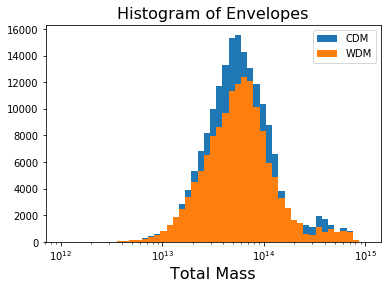

(772471650340768.0, 181751, 36350)

In [32]:
bins=np.logspace(np.log10(1e12),np.log10(1e15), 50)
# plt.hist(cdm_top_envelope_mass, bins=bins,label='CDM top',density=True)
# plt.hist(cdm_low_envelope_mass,bins=bins,label='CDM low',density=True)
#plt.hist(wdm_top_envelope_mass, bins=bins,label='WDM top')
#plt.hist(wdm_low_envelope_mass,bins=bins,label='WDM low')
plt.hist(cdm_envelope_mass,bins=bins,label='CDM')
plt.hist(wdm_envelope_mass,bins=bins,label='WDM')
plt.xscale("Log")
plt.xlabel("Total Mass", fontsize=16)
plt.title("Histogram of Envelopes", fontsize=16)
plt.legend()
plt.show()

np.max(cdm_top_envelope_mass),len(cdm_envelope_mass),len(cdm_low_envelope_mass)

### Plot CDM first

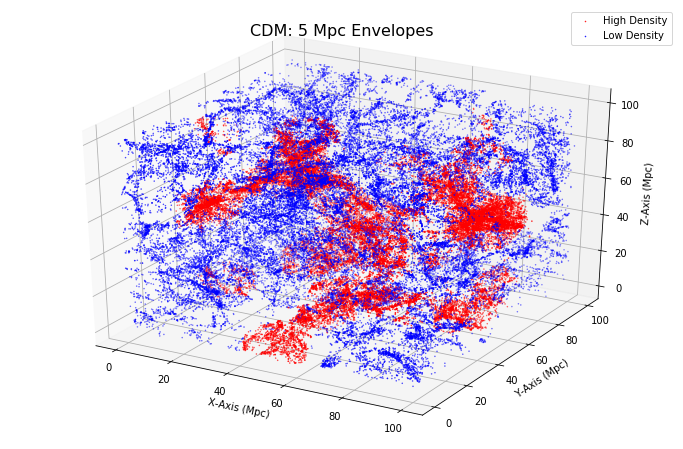

In [15]:
#set decimation factor
d=1

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(cdm_top_envelope_position[:,0][0::d],
           cdm_top_envelope_position[:,1][0::d],
           cdm_top_envelope_position[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(cdm_low_envelope_position[:,0][0::d],
           cdm_low_envelope_position[:,1][0::d],
           cdm_low_envelope_position[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("CDM: 5 Mpc Envelopes", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

# plt.savefig('Images/Environment/CDM_Galaxy_Envelope_Position.pdf')
plt.show()

In [32]:
#set decimation factor
d=1

trace1=go.Scatter3d(x=cdm_top_envelope_position[:,0][0::d],
           y=cdm_top_envelope_position[:,1][0::d],
           z=cdm_top_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='red',size=0.5,symbol='circle'),opacity=1)
trace2=go.Scatter3d(x=cdm_low_envelope_position[:,0][0::d],
           y=cdm_low_envelope_position[:,1][0::d],
           z=cdm_low_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='blue',size=0.5,symbol='circle'),opacity=1)

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))

fig = go.Figure(data=data, layout=layout)

py_offline.init_notebook_mode(connected=True)
py_offline.iplot(fig)

In [26]:
np.max(cdm_top_envelope_position[:,2])

bottom=40
top=60

cdm_ind=[(cdm_top_envelope_position[:,0]>bottom) & (cdm_top_envelope_position[:,0]<top),
         (cdm_top_envelope_position[:,1]>bottom) & (cdm_top_envelope_position[:,1]<top),
         (cdm_top_envelope_position[:,2]>bottom) & (cdm_top_envelope_position[:,2]<top)]

cdm_top_envelope_position[cdm_ind[2]][:,0]

array([17.43208122, 19.06316185,  2.55267882, ..., 82.37589264,
        2.2900064 ,  7.28926134])

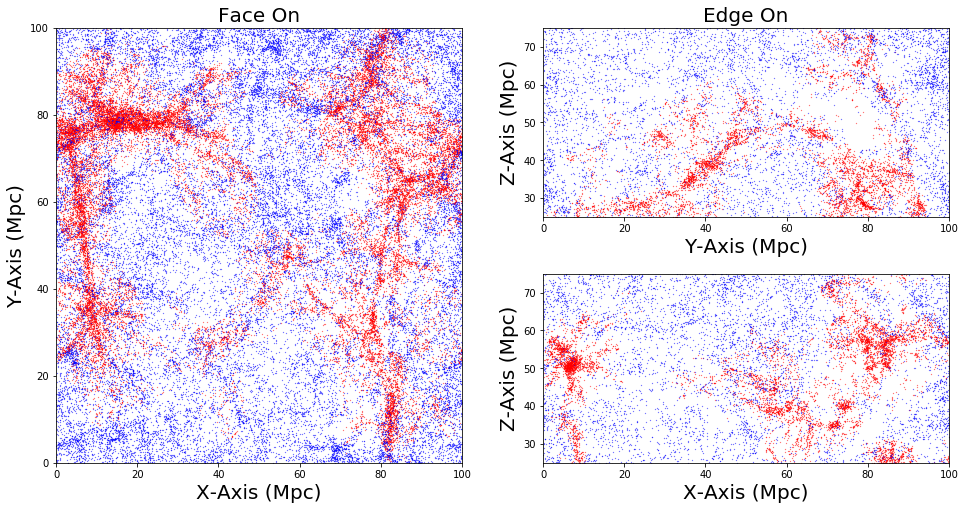

In [27]:
fig = plt.figure(figsize = (16,8))
gs = gridspec.GridSpec(2, 2)

ax1 = fig.add_subplot(gs[:,0])
ax1.scatter(cdm_top_envelope_position[cdm_ind[2]][:,0][0::d],
            cdm_top_envelope_position[cdm_ind[2]][:,1][0::d], s = 0.05,label="High Density",c='r')
ax1.scatter(cdm_low_envelope_position[cdm_ind[2]][:,0][0::d],
            cdm_low_envelope_position[cdm_ind[2]][:,1][0::d], s = 0.05,label="Low Density",c='b')
ax1.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax1.set_ylabel('Y-Axis (Mpc)', fontsize = 20)
ax1.set_title('Face On', fontsize = 20)
ax1.set_ylim(0,100)

ax2 = fig.add_subplot(gs[:1,1])
ax2.scatter(cdm_top_envelope_position[cdm_ind[0]][:,1][0::d],
            cdm_top_envelope_position[cdm_ind[0]][:,2][0::d], s = 0.05,label="High Density",c='r')
ax2.scatter(cdm_low_envelope_position[cdm_ind[0]][:,1][0::d],
            cdm_low_envelope_position[cdm_ind[0]][:,2][0::d], s = 0.05,label="Low Density",c='b')
ax2.set_xlabel('Y-Axis (Mpc)', fontsize = 20)
ax2.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax2.set_title('Edge On', fontsize = 20)
ax2.set_ylim(25,75)

ax3 = fig.add_subplot(gs[1:,1])
ax3.scatter(cdm_top_envelope_position[cdm_ind[1]][:,0][0::d],
            cdm_top_envelope_position[cdm_ind[1]][:,2][0::d], s = 0.05,label="High Density",c='r')
ax3.scatter(cdm_low_envelope_position[cdm_ind[1]][:,0][0::d],
            cdm_low_envelope_position[cdm_ind[1]][:,2][0::d], s = 0.05,label="Low Density",c='b')
ax3.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax3.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax3.set_ylim(25,75)

for axis in [ax1, ax2, ax3]:
    axis.set_xlim(0,100)

gs.update(wspace=0.2, hspace=0.3)
fig.savefig('Images/Environment/CDM_2D_Envelope_Mass_Plot_Galaxy_40Mpc.pdf')              
plt.show()

### Then WDM

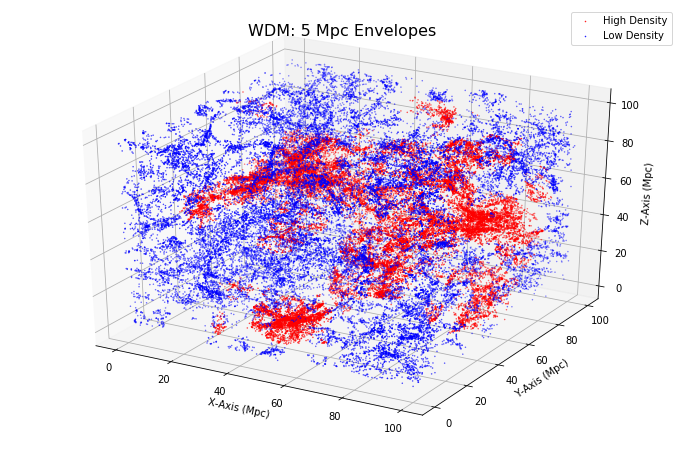

In [120]:
#set decimation factor
d=1

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(wdm_top_envelope_position[:,0][0::d],
           wdm_top_envelope_position[:,1][0::d],
           wdm_top_envelope_position[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(wdm_low_envelope_position[:,0][0::d],
           wdm_low_envelope_position[:,1][0::d],
           wdm_low_envelope_position[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("WDM: 5 Mpc Envelopes", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

plt.savefig('Images/Environment/WDM_Galaxy_Envelope_Position.pdf')
plt.show()

In [91]:
#set decimation factor
d=1

trace1=go.Scatter3d(x=wdm_top_envelope_position[:,0][0::d],
           y=wdm_top_envelope_position[:,1][0::d],
           z=wdm_top_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='red',size=0.5,symbol='circle'),opacity=1)
trace2=go.Scatter3d(x=wdm_low_envelope_position[:,0][0::d],
           y=wdm_low_envelope_position[:,1][0::d],
           z=wdm_low_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='blue',size=0.5,symbol='circle'),opacity=1)

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))

fig = go.Figure(data=data, layout=layout)

py_offline.init_notebook_mode(connected=True)
py_offline.iplot(fig)

In [29]:
wdm_ind=[(wdm_top_envelope_position[:,0]>bottom) & (wdm_top_envelope_position[:,0]<top),
         (wdm_top_envelope_position[:,1]>bottom) & (wdm_top_envelope_position[:,1]<top),
         (wdm_top_envelope_position[:,2]>bottom) & (wdm_top_envelope_position[:,2]<top)]

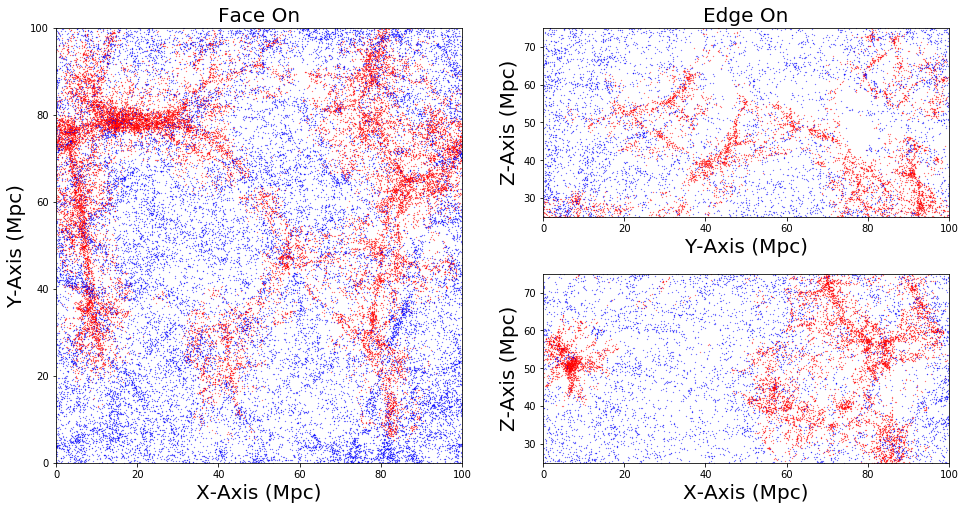

In [30]:
fig = plt.figure(figsize = (16,8))
gs = gridspec.GridSpec(2, 2)

ax1 = fig.add_subplot(gs[:,0])
ax1.scatter(wdm_top_envelope_position[wdm_ind[2]][:,0][0::d],
            wdm_top_envelope_position[wdm_ind[2]][:,1][0::d], s = 0.05,label="High Density",c='r')
ax1.scatter(wdm_low_envelope_position[wdm_ind[2]][:,0][0::d],
            wdm_low_envelope_position[wdm_ind[2]][:,1][0::d], s = 0.05,label="Low Density",c='b')
ax1.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax1.set_ylabel('Y-Axis (Mpc)', fontsize = 20)
ax1.set_title('Face On', fontsize = 20)
ax1.set_ylim(0,100)

ax2 = fig.add_subplot(gs[:1,1])
ax2.scatter(wdm_top_envelope_position[wdm_ind[0]][:,1][0::d],
            wdm_top_envelope_position[wdm_ind[0]][:,2][0::d], s = 0.05,label="High Density",c='r')
ax2.scatter(wdm_low_envelope_position[wdm_ind[0]][:,1][0::d],
            wdm_low_envelope_position[wdm_ind[0]][:,2][0::d], s = 0.05,label="Low Density",c='b')
ax2.set_xlabel('Y-Axis (Mpc)', fontsize = 20)
ax2.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax2.set_title('Edge On', fontsize = 20)
ax2.set_ylim(25,75)

ax3 = fig.add_subplot(gs[1:,1])
ax3.scatter(wdm_top_envelope_position[wdm_ind[1]][:,0][0::d],
            wdm_top_envelope_position[wdm_ind[1]][:,2][0::d], s = 0.05,label="High Density",c='r')
ax3.scatter(wdm_low_envelope_position[wdm_ind[1]][:,0][0::d],
            wdm_low_envelope_position[wdm_ind[1]][:,2][0::d], s = 0.05,label="Low Density",c='b')
ax3.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax3.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax3.set_ylim(25,75)

for axis in [ax1, ax2, ax3]:
    axis.set_xlim(0,100)

gs.update(wspace=0.2, hspace=0.3)
fig.savefig('Images/Environment/WDM_2D_Envelope_Mass_Plot_Galaxy_40Mpc.pdf')              
plt.show()

NOTES: best to use the actual dark matter particles, not even halos, much less galaxies --> not all dm halos contain galaxies bc of agn feedback! so even more biased tracer of environment. and not all dm particles are in halos

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:23: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:37: RuntimeWarning:

invalid value encountered in true_divide



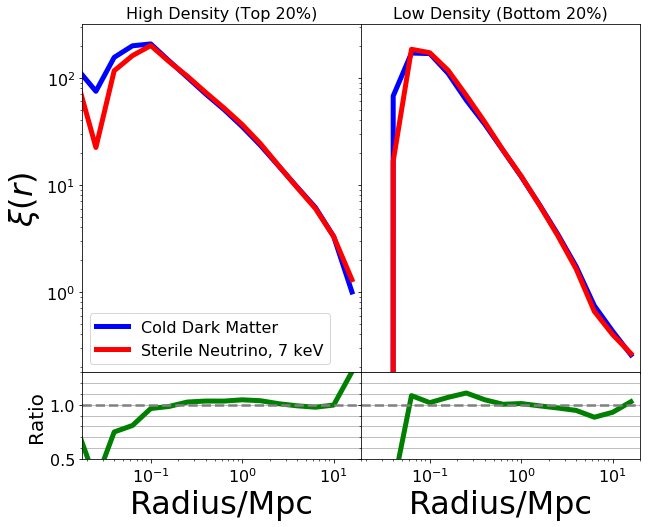

In [23]:
CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high.txt", usecols = (0,1))
CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low.txt", usecols = (0,1))
CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high.txt", usecols = (0,1))
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low.txt", usecols = (0,1))

plt.figure(figsize=(10,8))
grid = gridspec.GridSpec(2,2, height_ratios = [4,1])
grid.update(hspace = 0, wspace = 0)
grid0 = plt.subplot(grid[0])
grid1 = plt.subplot(grid[1])
grid2 = plt.subplot(grid[2])
grid3 = plt.subplot(grid[3])

#High density
grid0.loglog(CUTE_cdm_high[:,0], CUTE_cdm_high[:,1], label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid0.loglog(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1], label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid0.set_xlim(10**-1.75, 2e1)
grid0.set_ylim(10**-0.5, 10**2.5)
grid0.set_ylabel(r"$\xi(r)$", fontsize = 32)
grid0.legend(fontsize = 16)
grid0.set_title('High Density (Top 20%)',fontsize=16)

grid2.semilogx(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1]/CUTE_cdm_high[:,1], linewidth = 5, color = "green")
grid2.set_xlabel("Radius/Mpc", fontsize = 32)
grid2.set_ylabel("Ratio", fontsize=20)
grid2.axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)
grid2.set_xlim(10**-1.75, 2e1)
grid2.set_ylim(0.4, 1.4)

#Low density
grid1.loglog(CUTE_cdm_low[:,0], CUTE_cdm_low[:,1], label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid1.loglog(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1], label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid1.set_xlim(10**-1.75, 2e1)
grid1.set_ylim(10**-0.5, 10**2.5)
grid1.set_title('Low Density (Bottom 20%)',fontsize=16)

grid3.semilogx(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1]/CUTE_cdm_low[:,1], linewidth = 5, color = "green")
grid3.set_xlabel("Radius/Mpc", fontsize = 32)
grid3.axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)
grid3.set_xlim(10**-1.75, 2e1)
grid3.set_ylim(0.4, 1.4)

for i in range(4):
    plt.subplot(grid[i]).set_xlim(10**-1.75, 2e1)
    plt.subplot(grid[i]).minorticks_on()
    plt.subplot(grid[i]).tick_params(labelsize=16)
    
for i in [0,1]:
    plt.subplot(grid[i]).set_ylim(10**-0.75, 10**2.5)
    
for i in [2,3]:
    plt.subplot(grid[i]).set_ylim(0.5, 1.3)
    plt.subplot(grid[i]).yaxis.grid(which = "both")
    
for i in [1,3]:
    plt.subplot(grid[i]).set_yticklabels([])
    
# plt.savefig("Images/Environment/Corrfunc_High_Low_Density.pdf")
plt.show()

Things to do:
1. ~~Do fixed number density!!! and try to do not too optimistic a number of galaxies --> 10^6 and more massive at least~~
2. redo with high red shift for color and normal fixed mass abundance stuff
3. plummeting is bc low density by definition void regions can't be close together --> make a histogram of all pair separations: curve in black for pair separations of all galaxies vs high density/low density regions
4. Convert from 3d to 2d...?

paper:
1. show slices of position (face view etc for one)
2. stellar mass function in high density regions vs void regions --> tough to form structure in wdm and even more tough in void regions so hypothesis is more difference in void regions
3. then show correlation function

# Try it again with fixed abundance
### Do n = ~0.14 Galaxy/Mpc^3 first

In [13]:
#find masses of central galaxies
cdm_galaxy_mass_central = cdm_galaxy_mass[cdm_galaxy_central_ind]
wdm_galaxy_mass_central = wdm_galaxy_mass[wdm_galaxy_central_ind]

len(cdm_galaxy_mass_central), len(wdm_galaxy_mass_central)

(181751, 146478)

In [14]:
cdm_galaxy_mass_ind = sorted(range(len(cdm_galaxy_mass_central)), key=lambda k: cdm_galaxy_mass_central[k], reverse = True)
wdm_galaxy_mass_ind = sorted(range(len(wdm_galaxy_mass_central)), key=lambda k: wdm_galaxy_mass_central[k], reverse = True)

cdm_galaxy_mass_central[cdm_galaxy_mass_ind], wdm_galaxy_mass_central[wdm_galaxy_mass_ind], \
cdm_galaxy_mass_central[cdm_galaxy_mass_ind[:139741]], wdm_galaxy_mass_central[wdm_galaxy_mass_ind[:139741]]

(array([3.81787046e+11, 3.56176069e+11, 3.55112714e+11, ...,
        1.40853190e+00, 1.39337444e+00, 9.48986411e-01]),
 array([4.49988231e+11, 4.41800557e+11, 3.80657369e+11, ...,
        4.48565102e+00, 4.41240835e+00, 3.80794263e+00]),
 array([3.81787046e+11, 3.56176069e+11, 3.55112714e+11, ...,
        3.27785150e+06, 3.27775675e+06, 3.27775225e+06]),
 array([4.49988231e+11, 4.41800557e+11, 3.80657369e+11, ...,
        1.00017544e+06, 1.00006862e+06, 1.00000881e+06]))

In [15]:
cdm_envelope_mass_sorted=cdm_envelope_mass[cdm_galaxy_mass_ind[:139741]]
wdm_envelope_mass_sorted=wdm_envelope_mass[wdm_galaxy_mass_ind[:139741]]

In [16]:
cdm_galaxy_position_central_sorted=cdm_galaxy_position_central[cdm_galaxy_mass_ind[:139741]]
wdm_galaxy_position_central_sorted=wdm_galaxy_position_central[wdm_galaxy_mass_ind[:139741]]

### Get the top/bottom 20% densest regions

In [17]:
frac = 20.0
th_low_cdm = np.percentile(cdm_envelope_mass_sorted,frac)
th_top_cdm = np.percentile(cdm_envelope_mass_sorted,100.-frac)
th_low_wdm = np.percentile(wdm_envelope_mass_sorted,frac)
th_top_wdm = np.percentile(wdm_envelope_mass_sorted,100.-frac)

cdm_top_envelope_position_sorted = cdm_galaxy_position_central_sorted[cdm_envelope_mass_sorted>th_top_cdm]
cdm_low_envelope_position_sorted = cdm_galaxy_position_central_sorted[cdm_envelope_mass_sorted<th_low_cdm]
wdm_top_envelope_position_sorted = wdm_galaxy_position_central_sorted[wdm_envelope_mass_sorted>th_top_wdm]
wdm_low_envelope_position_sorted = wdm_galaxy_position_central_sorted[wdm_envelope_mass_sorted<th_low_wdm]

In [57]:
# np.savetxt("Input/cdm_galaxy_pos_environment_high_sorted.txt", cdm_top_envelope_position_sorted, fmt = "%f %f %f")
# np.savetxt("Input/cdm_galaxy_pos_environment_low_sorted.txt", cdm_low_envelope_position_sorted, fmt = "%f %f %f")
# np.savetxt("Input/wdm_galaxy_pos_environment_high_sorted.txt", wdm_top_envelope_position_sorted, fmt = "%f %f %f")
# np.savetxt("Input/wdm_galaxy_pos_environment_low_sorted.txt", wdm_low_envelope_position_sorted, fmt = "%f %f %f")

# Plot!

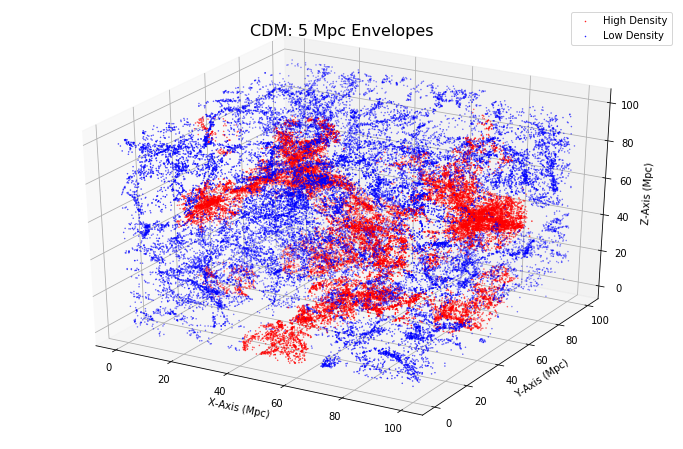

In [58]:
#set decimation factor
d=1

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(cdm_top_envelope_position_sorted[:,0][0::d],
           cdm_top_envelope_position_sorted[:,1][0::d],
           cdm_top_envelope_position_sorted[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(cdm_low_envelope_position_sorted[:,0][0::d],
           cdm_low_envelope_position_sorted[:,1][0::d],
           cdm_low_envelope_position_sorted[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("CDM: 5 Mpc Envelopes", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

# plt.savefig('Images/Environment/CDM_Galaxy_Envelope_Position.pdf')
plt.show()

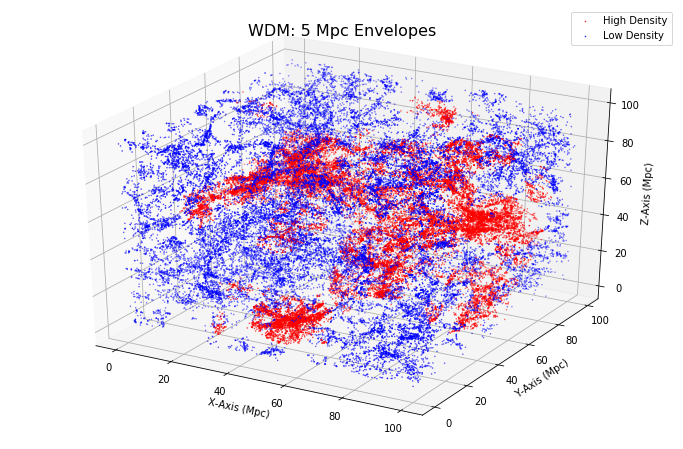

In [59]:
#set decimation factor
d=1

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(wdm_top_envelope_position_sorted[:,0][0::d],
           wdm_top_envelope_position_sorted[:,1][0::d],
           wdm_top_envelope_position_sorted[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(wdm_low_envelope_position_sorted[:,0][0::d],
           wdm_low_envelope_position_sorted[:,1][0::d],
           wdm_low_envelope_position_sorted[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("WDM: 5 Mpc Envelopes", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

# plt.savefig('Images/Environment/WDM_Galaxy_Envelope_Position.pdf')
plt.show()

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:36: RuntimeWarning:

invalid value encountered in true_divide



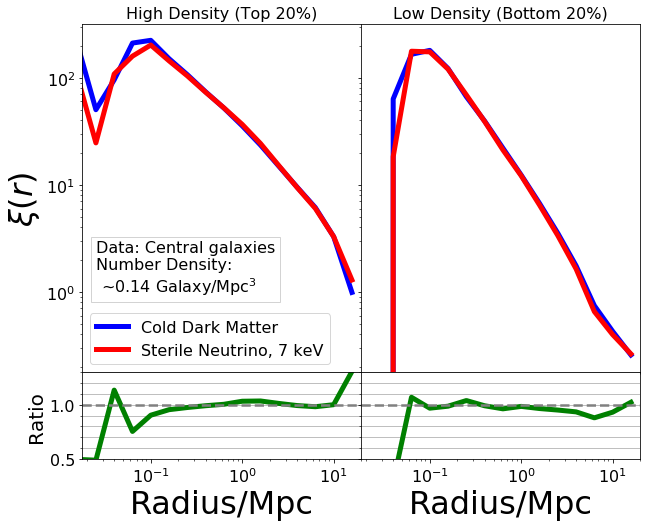

In [82]:
CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high_sorted.txt", usecols = (0,1))
CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low_sorted.txt", usecols = (0,1))
CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high_sorted.txt", usecols = (0,1))
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted.txt", usecols = (0,1))

textstr = '\n'.join((
    r'Data: Central galaxies',
    'Number Density: \n ~0.14 Galaxy/Mpc$^{3}$'))
props = dict(facecolor='none', edgecolor='lightgrey', pad = 5.0)

plt.figure(figsize=(10,8))
grid = gridspec.GridSpec(2,2, height_ratios = [4,1])
grid.update(hspace = 0, wspace = 0)
grid0 = plt.subplot(grid[0])
grid1 = plt.subplot(grid[1])
grid2 = plt.subplot(grid[2])
grid3 = plt.subplot(grid[3])

#High density
grid0.loglog(CUTE_cdm_high[:,0], CUTE_cdm_high[:,1], label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid0.loglog(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1], label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid0.set_ylabel(r"$\xi(r)$", fontsize = 32)
grid0.legend(fontsize = 16)
grid0.set_title('High Density (Top 20%)',fontsize=16)
grid0.text(0.05, 0.375, textstr, transform=grid0.transAxes, fontsize=16,
        verticalalignment='top', bbox=props)

grid2.semilogx(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1]/CUTE_cdm_high[:,1], linewidth = 5, color = "green")
grid2.set_ylabel("Ratio", fontsize=20)

#Low density
grid1.loglog(CUTE_cdm_low[:,0], CUTE_cdm_low[:,1], label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid1.loglog(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1], label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid1.set_title('Low Density (Bottom 20%)',fontsize=16)

grid3.semilogx(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1]/CUTE_cdm_low[:,1], linewidth = 5, color = "green")

for i in range(4):
    plt.subplot(grid[i]).set_xlim(10**-1.75, 2e1)
    plt.subplot(grid[i]).minorticks_on()
    plt.subplot(grid[i]).tick_params(labelsize=16)
    
for i in [0,1]:
    plt.subplot(grid[i]).set_ylim(10**-0.75, 10**2.5)
    
for i in [2,3]:
    plt.subplot(grid[i]).set_ylim(0.5, 1.3)
    plt.subplot(grid[i]).yaxis.grid(which = "both")
    plt.subplot(grid[i]).set_xlabel("Radius/Mpc", fontsize = 32)
    plt.subplot(grid[i]).axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)
    
for i in [1,3]:
    plt.subplot(grid[i]).set_yticklabels([])
    
# plt.savefig("Images/Environment/Corrfunc_High_Low_Density_Sorted.pdf")
plt.show()

### Now do n = 0.1, 0.03, and 0.001 Galaxy/Mpc^3

In [99]:
for abundance in [100000,30000,1000]:
    #get the masses
    cdm_envelope_mass_sorted=cdm_envelope_mass[cdm_galaxy_mass_ind[:abundance]]
    wdm_envelope_mass_sorted=wdm_envelope_mass[wdm_galaxy_mass_ind[:abundance]]

    #get the positions
    cdm_galaxy_position_central_sorted=cdm_galaxy_position_central[cdm_galaxy_mass_ind[:abundance]]
    wdm_galaxy_position_central_sorted=wdm_galaxy_position_central[wdm_galaxy_mass_ind[:abundance]]

    frac = 20.0
    th_low_cdm = np.percentile(cdm_envelope_mass_sorted,frac)
    th_top_cdm = np.percentile(cdm_envelope_mass_sorted,100.-frac)
    th_low_wdm = np.percentile(wdm_envelope_mass_sorted,frac)
    th_top_wdm = np.percentile(wdm_envelope_mass_sorted,100.-frac)

    cdm_top_envelope_position_sorted = cdm_galaxy_position_central_sorted[cdm_envelope_mass_sorted>th_top_cdm]
    cdm_low_envelope_position_sorted = cdm_galaxy_position_central_sorted[cdm_envelope_mass_sorted<th_low_cdm]
    wdm_top_envelope_position_sorted = wdm_galaxy_position_central_sorted[wdm_envelope_mass_sorted>th_top_wdm]
    wdm_low_envelope_position_sorted = wdm_galaxy_position_central_sorted[wdm_envelope_mass_sorted<th_low_wdm]

#     np.savetxt("Input/cdm_galaxy_pos_environment_high_sorted_"+str(abundance)+".txt", 
#                cdm_top_envelope_position_sorted, fmt = "%f %f %f")
#     np.savetxt("Input/cdm_galaxy_pos_environment_low_sorted_"+str(abundance)+".txt", 
#                cdm_low_envelope_position_sorted, fmt = "%f %f %f")
#     np.savetxt("Input/wdm_galaxy_pos_environment_high_sorted_"+str(abundance)+".txt", 
#                wdm_top_envelope_position_sorted, fmt = "%f %f %f")
#     np.savetxt("Input/wdm_galaxy_pos_environment_low_sorted_"+str(abundance)+".txt", 
#                wdm_low_envelope_position_sorted, fmt = "%f %f %f")

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:45: RuntimeWarning:

invalid value encountered in true_divide



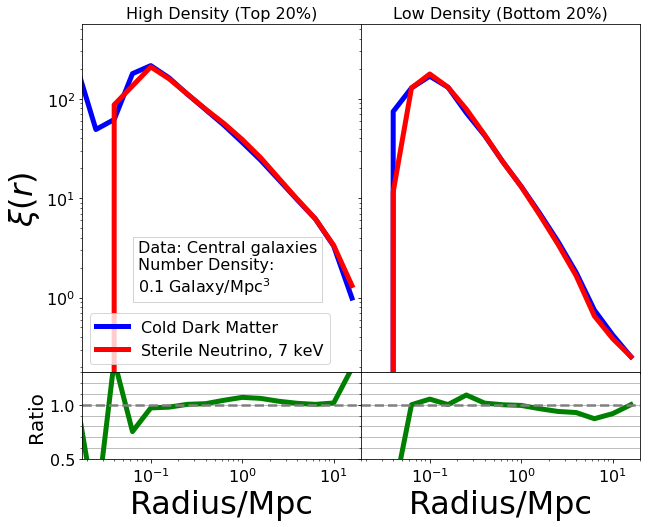

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:35: RuntimeWarning:

divide by zero encountered in true_divide



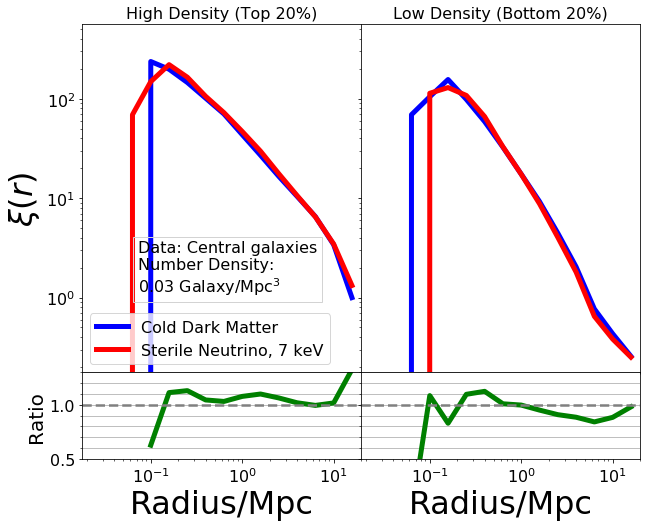

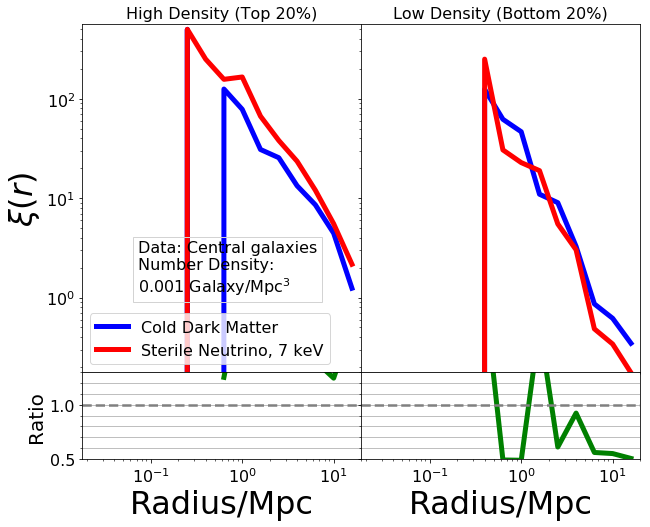

In [23]:
# for abundance in [100000,30000,1000]:
#     CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high_sorted_"+str(abundance)+".txt", 
#                                   usecols = (0,1))
#     CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low_sorted_"+str(abundance)+".txt", 
#                                  usecols = (0,1))
#     CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high_sorted_"+str(abundance)+".txt", 
#                                   usecols = (0,1))
#     CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted_"+str(abundance)+".txt", 
#                                  usecols = (0,1))

#     textstr = '\n'.join((
#         r'Data: Central galaxies',
#         'Number Density: \n'+str(abundance/10.**6)+' Galaxy/Mpc$^{3}$'))
#     props = dict(facecolor='none', edgecolor='lightgrey', pad = 5.0)

#     plt.figure(figsize=(10,8))
#     grid = gridspec.GridSpec(2,2, height_ratios = [4,1])
#     grid.update(hspace = 0, wspace = 0)
#     grid0 = plt.subplot(grid[0])
#     grid1 = plt.subplot(grid[1])
#     grid2 = plt.subplot(grid[2])
#     grid3 = plt.subplot(grid[3])

#     #High density
#     grid0.loglog(CUTE_cdm_high[:,0], CUTE_cdm_high[:,1], 
#                  label = "Cold Dark Matter", linewidth = 5, color = "blue")
#     grid0.loglog(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1], 
#                  label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
#     grid0.set_ylabel(r"$\xi(r)$", fontsize = 32)
#     grid0.legend(fontsize = 16)
#     grid0.set_title('High Density (Top 20%)',fontsize=16)
#     grid0.text(0.2, 0.375, textstr, transform=grid0.transAxes, fontsize=16,
#             verticalalignment='top', bbox=props)

#     grid2.semilogx(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1]/CUTE_cdm_high[:,1], linewidth = 5, color = "green")
#     grid2.set_ylabel("Ratio", fontsize=20)

#     #Low density
#     grid1.loglog(CUTE_cdm_low[:,0], CUTE_cdm_low[:,1], 
#                  label = "Cold Dark Matter", linewidth = 5, color = "blue")
#     grid1.loglog(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1], 
#                  label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
#     grid1.set_title('Low Density (Bottom 20%)',fontsize=16)

#     grid3.semilogx(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1]/CUTE_cdm_low[:,1], linewidth = 5, color = "green")

#     for i in range(4):
#         plt.subplot(grid[i]).set_xlim(10**-1.75, 2e1)
#         plt.subplot(grid[i]).minorticks_on()
#         plt.subplot(grid[i]).tick_params(labelsize=16)

#     for i in [0,1]:
#         plt.subplot(grid[i]).set_ylim(10**-0.75, 10**2.75)

#     for i in [2,3]:
#         plt.subplot(grid[i]).set_ylim(0.5, 1.3)
#         plt.subplot(grid[i]).yaxis.grid(which = "both")
#         plt.subplot(grid[i]).set_xlabel("Radius/Mpc", fontsize = 32)
#         plt.subplot(grid[i]).axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)

#     for i in [1,3]:
#         plt.subplot(grid[i]).set_yticklabels([])

#     plt.savefig("Images/Environment/Corrfunc_High_Low_Density_Sorted_"+str(abundance)+".pdf")
#     plt.show()

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning:

invalid value encountered in true_divide



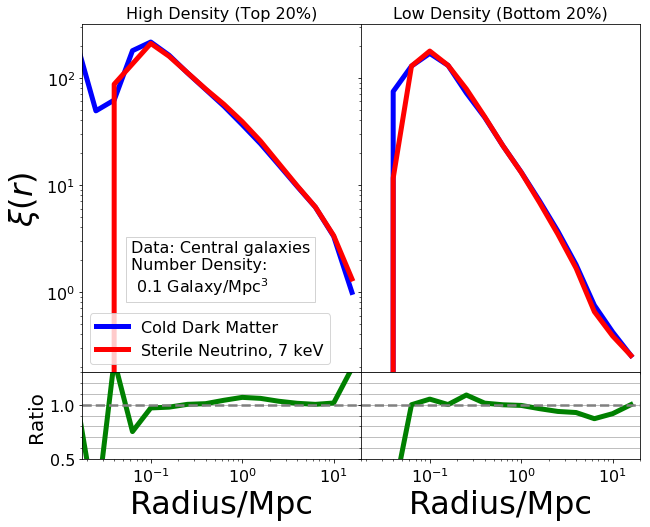

In [15]:
CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high_sorted_100000.txt", usecols = (0,1))
CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low_sorted_100000.txt", usecols = (0,1))
CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high_sorted_100000.txt", usecols = (0,1))
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted_100000.txt", usecols = (0,1))

textstr = '\n'.join((
    r'Data: Central galaxies',
    'Number Density: \n 0.1 Galaxy/Mpc$^{3}$'))
props = dict(facecolor='none', edgecolor='lightgrey', pad = 5.0)

plt.figure(figsize=(10,8))
grid = gridspec.GridSpec(2,2, height_ratios = [4,1])
grid.update(hspace = 0, wspace = 0)
grid0 = plt.subplot(grid[0])
grid1 = plt.subplot(grid[1])
grid2 = plt.subplot(grid[2])
grid3 = plt.subplot(grid[3])

#High density
grid0.loglog(CUTE_cdm_high[:,0], CUTE_cdm_high[:,1], 
             label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid0.loglog(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1], 
             label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid0.set_ylabel(r"$\xi(r)$", fontsize = 32)
grid0.legend(fontsize = 16)
grid0.set_title('High Density (Top 20%)',fontsize=16)
grid0.text(0.175, 0.375, textstr, transform=grid0.transAxes, fontsize=16,
        verticalalignment='top', bbox=props)

grid2.semilogx(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1]/CUTE_cdm_high[:,1], linewidth = 5, color = "green")
grid2.set_ylabel("Ratio", fontsize=20)

#Low density
grid1.loglog(CUTE_cdm_low[:,0], CUTE_cdm_low[:,1], 
             label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid1.loglog(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1], 
             label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid1.set_title('Low Density (Bottom 20%)',fontsize=16)

grid3.semilogx(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1]/CUTE_cdm_low[:,1], linewidth = 5, color = "green")

for i in range(4):
    plt.subplot(grid[i]).set_xlim(10**-1.75, 2e1)
    plt.subplot(grid[i]).minorticks_on()
    plt.subplot(grid[i]).tick_params(labelsize=16)

for i in [0,1]:
    plt.subplot(grid[i]).set_ylim(10**-0.75, 10**2.5)

for i in [2,3]:
    plt.subplot(grid[i]).set_ylim(0.5, 1.3)
    plt.subplot(grid[i]).yaxis.grid(which = "both")
    plt.subplot(grid[i]).set_xlabel("Radius/Mpc", fontsize = 32)
    plt.subplot(grid[i]).axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)

for i in [1,3]:
    plt.subplot(grid[i]).set_yticklabels([])

# plt.savefig("Images/Environment/Corrfunc_High_Low_Density_Sorted_100000.pdf")
plt.show()

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning:

divide by zero encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning:

invalid value encountered in true_divide



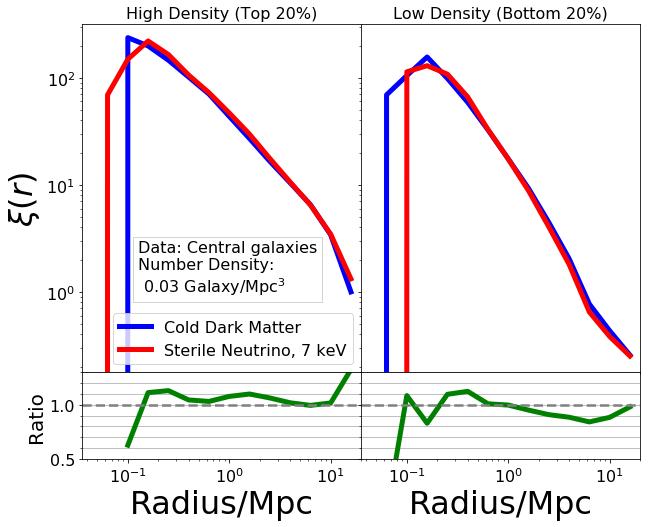

In [14]:
CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high_sorted_30000.txt", usecols = (0,1))
CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low_sorted_30000.txt", usecols = (0,1))
CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high_sorted_30000.txt", usecols = (0,1))
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted_30000.txt", usecols = (0,1))

textstr = '\n'.join((
    r'Data: Central galaxies',
    'Number Density: \n 0.03 Galaxy/Mpc$^{3}$'))
props = dict(facecolor='none', edgecolor='lightgrey', pad = 5.0)

plt.figure(figsize=(10,8))
grid = gridspec.GridSpec(2,2, height_ratios = [4,1])
grid.update(hspace = 0, wspace = 0)
grid0 = plt.subplot(grid[0])
grid1 = plt.subplot(grid[1])
grid2 = plt.subplot(grid[2])
grid3 = plt.subplot(grid[3])

#High density
grid0.loglog(CUTE_cdm_high[:,0], CUTE_cdm_high[:,1], 
             label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid0.loglog(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1], 
             label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid0.set_ylabel(r"$\xi(r)$", fontsize = 32)
grid0.legend(fontsize = 16)
grid0.set_title('High Density (Top 20%)',fontsize=16)
grid0.text(0.2, 0.375, textstr, transform=grid0.transAxes, fontsize=16,
        verticalalignment='top', bbox=props)

grid2.semilogx(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1]/CUTE_cdm_high[:,1], linewidth = 5, color = "green")
grid2.set_ylabel("Ratio", fontsize=20)

#Low density
grid1.loglog(CUTE_cdm_low[:,0], CUTE_cdm_low[:,1], 
             label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid1.loglog(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1], 
             label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid1.set_title('Low Density (Bottom 20%)',fontsize=16)

grid3.semilogx(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1]/CUTE_cdm_low[:,1], linewidth = 5, color = "green")

for i in range(4):
    plt.subplot(grid[i]).set_xlim(10**-1.45, 2e1)
    plt.subplot(grid[i]).minorticks_on()
    plt.subplot(grid[i]).tick_params(labelsize=16)

for i in [0,1]:
    plt.subplot(grid[i]).set_ylim(10**-0.75, 10**2.5)

for i in [2,3]:
    plt.subplot(grid[i]).set_ylim(0.5, 1.3)
    plt.subplot(grid[i]).yaxis.grid(which = "both")
    plt.subplot(grid[i]).set_xlabel("Radius/Mpc", fontsize = 32)
    plt.subplot(grid[i]).axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)

for i in [1,3]:
    plt.subplot(grid[i]).set_yticklabels([])

# plt.savefig("Images/Environment/Corrfunc_High_Low_Density_Sorted_30000.pdf")
plt.show()

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: RuntimeWarning:

divide by zero encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:28: RuntimeWarning:

invalid value encountered in true_divide

C:\Users\shife\Anaconda3\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning:

invalid value encountered in true_divide



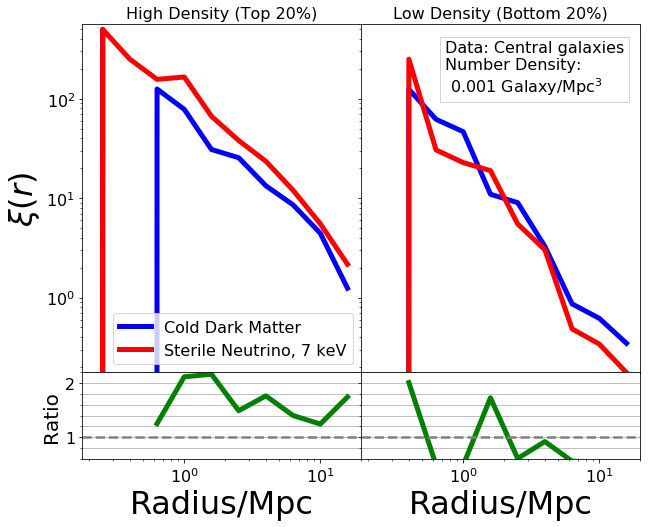

In [50]:
CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high_sorted_1000.txt", usecols = (0,1))
CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low_sorted_1000.txt", usecols = (0,1))
CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high_sorted_1000.txt", usecols = (0,1))
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted_1000.txt", usecols = (0,1))

textstr = '\n'.join((
    r'Data: Central galaxies',
    'Number Density: \n 0.001 Galaxy/Mpc$^{3}$'))
props = dict(facecolor='none', edgecolor='lightgrey', pad = 5.0)

plt.figure(figsize=(10,8))
grid = gridspec.GridSpec(2,2, height_ratios = [4,1])
grid.update(hspace = 0, wspace = 0)
grid0 = plt.subplot(grid[0])
grid1 = plt.subplot(grid[1])
grid2 = plt.subplot(grid[2])
grid3 = plt.subplot(grid[3])

#High density
grid0.loglog(CUTE_cdm_high[:,0], CUTE_cdm_high[:,1], 
             label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid0.loglog(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1], 
             label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid0.set_ylabel(r"$\xi(r)$", fontsize = 32)
grid0.legend(fontsize = 16)
grid0.set_title('High Density (Top 20%)',fontsize=16)

grid2.semilogx(CUTE_wdm_high[:,0], CUTE_wdm_high[:,1]/CUTE_cdm_high[:,1], linewidth = 5, color = "green")
grid2.set_ylabel("Ratio", fontsize=20)

#Low density
grid1.loglog(CUTE_cdm_low[:,0], CUTE_cdm_low[:,1], 
             label = "Cold Dark Matter", linewidth = 5, color = "blue")
grid1.loglog(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1], 
             label = "Sterile Neutrino, 7 keV", linewidth = 5, color = "red")
grid1.set_title('Low Density (Bottom 20%)',fontsize=16)
grid1.text(1.3, 0.95, textstr, transform=grid0.transAxes, fontsize=16,
        verticalalignment='top', bbox=props)

grid3.semilogx(CUTE_wdm_low[:,0], CUTE_wdm_low[:,1]/CUTE_cdm_low[:,1], linewidth = 5, color = "green")

for i in range(4):
    plt.subplot(grid[i]).set_xlim(10**-0.75, 2e1)
    plt.subplot(grid[i]).minorticks_on()
    plt.subplot(grid[i]).tick_params(labelsize=16)

for i in [0,1]:
    plt.subplot(grid[i]).set_ylim(10**-0.75, 10**2.75)

for i in [2,3]:
    plt.subplot(grid[i]).set_ylim(0.6, 2.2)
    plt.subplot(grid[i]).yaxis.grid(which = "both")
    plt.subplot(grid[i]).set_xlabel("Radius/Mpc", fontsize = 32)
    plt.subplot(grid[i]).axhline(y = 1, color = "grey", ls = "--", linewidth = 2.5)

for i in [1,3]:
    plt.subplot(grid[i]).set_yticklabels([])

# plt.savefig("Images/Environment/Corrfunc_High_Low_Density_Sorted_1000.pdf")
plt.show()

Sign into Odyssey: ssh mahletshiferaw@login.rc.fas.harvard.edu

Laptop to Odyssey: scp OneDrive/Harvard_Stuff/Astro_98/Input/filename.txt mahletshiferaw@odyssey.rc.fas.harvard.edu:~/CUTE/CUTE_box/input

Set number of threads: export OMP_NUM_THREADS=32

Odyssey to Laptop: scp mahletshiferaw@odyssey.rc.fas.harvard.edu:~/CUTE/CUTE_box/output/filename.txt OneDrive/Harvard_Stuff/Astro_98/Output 

# Make a histogram of all pair separations

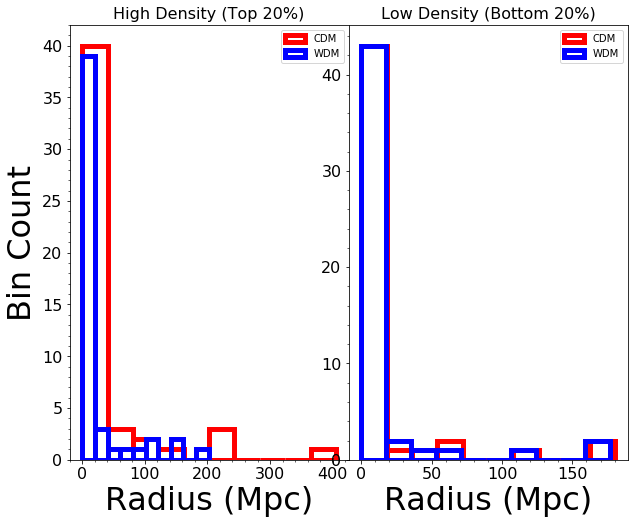

In [6]:
CUTE_cdm_high = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_high_sorted.txt", usecols = (0,1))
CUTE_cdm_low = np.genfromtxt("Output/corr_cdm_galaxy_pos_environment_low_sorted.txt", usecols = (0,1))
CUTE_wdm_high = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_high_sorted.txt", usecols = (0,1))
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted.txt", usecols = (0,1))

plt.figure(figsize=(10,8))
grid = gridspec.GridSpec(1,2)
grid.update(hspace = 0, wspace = 0)
grid0 = plt.subplot(grid[0])
grid1 = plt.subplot(grid[1])

grid0.hist(CUTE_cdm_high[:,1],fill=None,linewidth = 5,label="CDM",edgecolor='r')
grid0.hist(CUTE_wdm_high[:,1],fill=None,linewidth = 5,label="WDM",edgecolor='b')
grid0.set_ylabel('Bin Count',fontsize=32)

grid1.hist(CUTE_cdm_low[:,1],fill=None,linewidth = 5,label="CDM",edgecolor='r')
grid1.hist(CUTE_wdm_low[:,1],fill=None,linewidth = 5,label="WDM",edgecolor='b')

for i,title in zip([0,1],['High Density (Top 20%)','Low Density (Bottom 20%)']):
    plt.subplot(grid[i]).set_xlabel('Radius (Mpc)',fontsize=32)
    plt.subplot(grid[i]).set_title(title,fontsize=16)
    plt.subplot(grid[i]).minorticks_on()
    plt.subplot(grid[i]).tick_params(labelsize=16)
    plt.subplot(grid[i]).legend()

# plt.savefig('Images/Environment/Pair_Separation.pdf')
plt.show()

In [8]:
CUTE_cdm_low[:,0],CUTE_wdm_low[:,0]

(array([2.517851e-09, 3.990525e-09, 6.324555e-09, 1.002374e-08,
        1.588656e-08, 2.517851e-08, 3.990525e-08, 6.324555e-08,
        1.002374e-07, 1.588656e-07, 2.517851e-07, 3.990525e-07,
        6.324555e-07, 1.002374e-06, 1.588656e-06, 2.517851e-06,
        3.990525e-06, 6.324555e-06, 1.002374e-05, 1.588656e-05,
        2.517851e-05, 3.990525e-05, 6.324555e-05, 1.002374e-04,
        1.588656e-04, 2.517851e-04, 3.990525e-04, 6.324555e-04,
        1.002374e-03, 1.588656e-03, 2.517851e-03, 3.990525e-03,
        6.324555e-03, 1.002374e-02, 1.588656e-02, 2.517851e-02,
        3.990525e-02, 6.324555e-02, 1.002374e-01, 1.588656e-01,
        2.517851e-01, 3.990525e-01, 6.324555e-01, 1.002374e+00,
        1.588656e+00, 2.517851e+00, 3.990525e+00, 6.324555e+00,
        1.002374e+01, 1.588656e+01]),
 array([2.517851e-09, 3.990525e-09, 6.324555e-09, 1.002374e-08,
        1.588656e-08, 2.517851e-08, 3.990525e-08, 6.324555e-08,
        1.002374e-07, 1.588656e-07, 2.517851e-07, 3.990525e-07,
  

# Things to do
1. collapse to 2d: set z to 0 and redo correlation function because that's how we observe things
    2. do that for all measurements! --> start with basic comparison from early on and progress from that. tells us how important is to get accurate redshift measurements 
    3. do it for the normal fixed abundance calculations
2. take out the galaxies that are plotted and make a stellar mass function (in 0.001 galaxies/Mpc^3) case 
    3. make sure none are satellites and check number of galaxies being plotted
3. fix histogram plot
    1. make number distribution of how many galaxies fall into certain bins
        2. within each of these bins, how many galaxies fall into them?
    3. so calculate pair separation between every pair of galaxies for high/low density (and don't double count!)
        4. make histogram of distances! 

In [19]:
CUTE_wdm_low = np.genfromtxt("Output/corr_wdm_galaxy_pos_environment_low_sorted.txt", usecols = (0,1))

In [20]:
len(CUTE_wdm_low)

50